# Constants and useful functions

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
import math
import numpy as np
import xlsxwriter
from openpyxl import load_workbook

from ipynb.fs.full.UtilCollections import PARAMS, POSITIONS, SEASONS, TEAMS
from ipynb.fs.full.UtilFunctions import format_season

In [2]:
SEASONS = SEASONS[:-1]

In [3]:
pylab.rcParams.update(PARAMS)

In [4]:
def get_stat_by_position_each_season(stat, stats_by_pos):
    stat_by_pos_each_season = {}

    for position in POSITIONS:
        stat_by_pos_each_season[position] = []

    for season in stats_by_pos:    
        for position in season.index:
            if position in POSITIONS:
                stat_by_pos_each_season[position].append(season.loc[position][stat]) 
            
    return stat_by_pos_each_season


In [5]:
def plot_position_graph(positions_dict, graph_title, measure, playoffs=False):
    
    plt.figure(figsize=(12, 8), dpi=80)
    plt.grid()
    for position in POSITIONS:
        plt.plot(SEASONS[:], positions_dict[position], label=position, lw=3, marker='o', ms=10)

    plt.xticks(SEASONS[::3])
    plt.ylabel(f"{measure} {graph_title}", fontsize=18)
    plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
    
    if '/' in graph_title:
        graph_title = graph_title.replace('/', '_')

    if playoffs:
        plt.xlabel("Playoff Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution_Playoffs/{measure}_{graph_title}.png", bbox_inches='tight')
    else:
        plt.xlabel("Season", fontsize=18)
        plt.savefig(f"Results/PositionsEvolution/{measure}_{graph_title}.png", bbox_inches='tight')
    plt.show()

In [6]:
def get_csvs_by_season(season):
    first_year, second_year = format_season(season)
    
    player_df = pd.read_csv("DataCollection/Player_Stats/player_stats_{0}-{1}.csv".format(first_year, second_year))
    playoff_player_df = pd.read_csv("DataCollection/Player_Stats_Playoffs/player_stats_playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    return player_df, playoff_player_df

In [7]:
player_dfs, playoff_player_dfs = [], []

for season in SEASONS:
    player_df, playoff_player_df = get_csvs_by_season(season)
    player_dfs.append(player_df)
    playoff_player_dfs.append(playoff_player_df)


# Analyzing highest scorers by position

In [8]:
df = pd.DataFrame(player_dfs[-1].groupby(by=['Tm','Pos'])['PTS'].max())
df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)

In [9]:
highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)

In [10]:
position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1

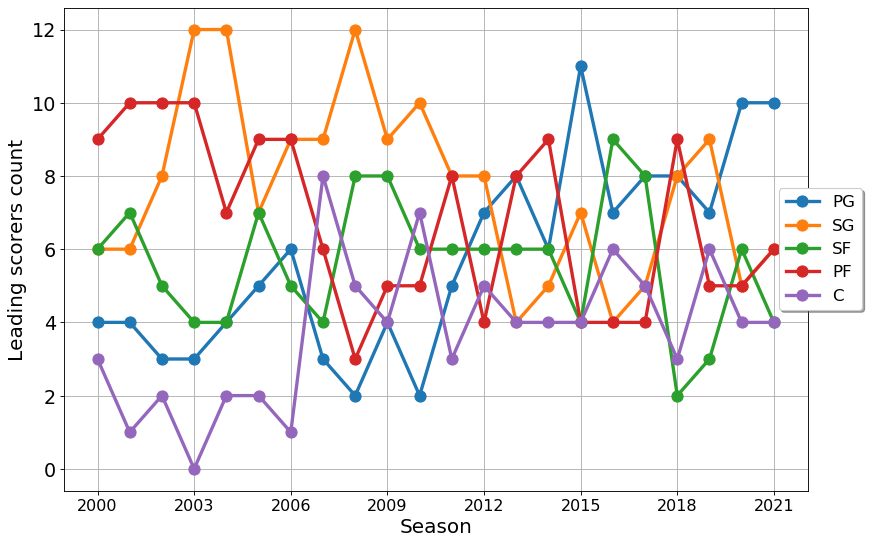

In [11]:
plt.figure(figsize=(12, 8), dpi=80)
for position in POSITIONS:
    plt.plot(SEASONS, position_with_more_scoring[position], label=position, lw=3, marker='o', ms=10)

plt.grid()
plt.xlabel("Season", fontsize=18)
plt.ylabel("Leading scorers count", fontsize=18)
plt.xticks(SEASONS[::3])
plt.legend(loc='center left', bbox_to_anchor=(0.95, 0.5),
          fancybox=True, shadow=True, ncol=1, prop={'size': 15})
plt.savefig("Results/PositionsEvolution/Positions_with_most_scoring.png", bbox_inches='tight')
plt.show()

# Analyzing the impact of positions by average stats

In [12]:
pd.set_option('display.max_rows', None)
df = pd.DataFrame(player_dfs[17].groupby(by=['Pos']).mean())
df.sort_values(by=['PTS', 'MP'], ascending=[False, False], inplace=True)

In [13]:
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
#     df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
#     df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    avg_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/AverageStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

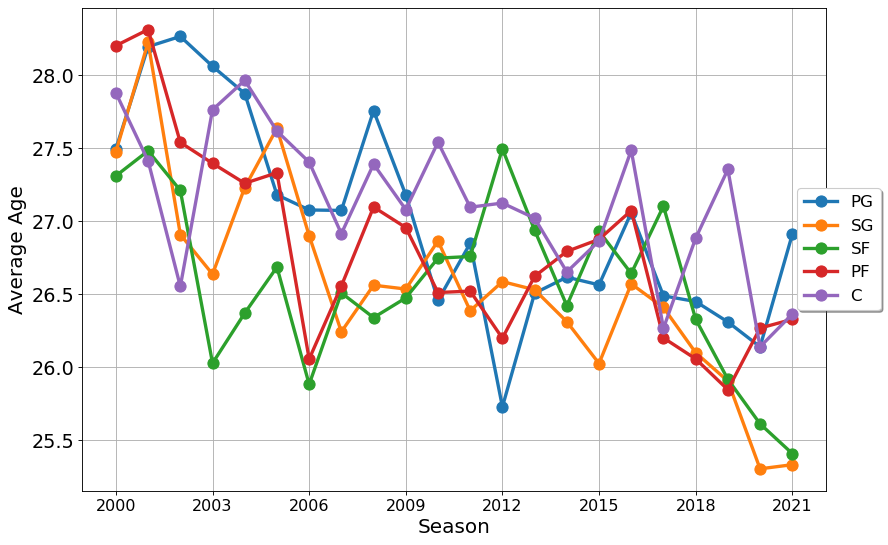

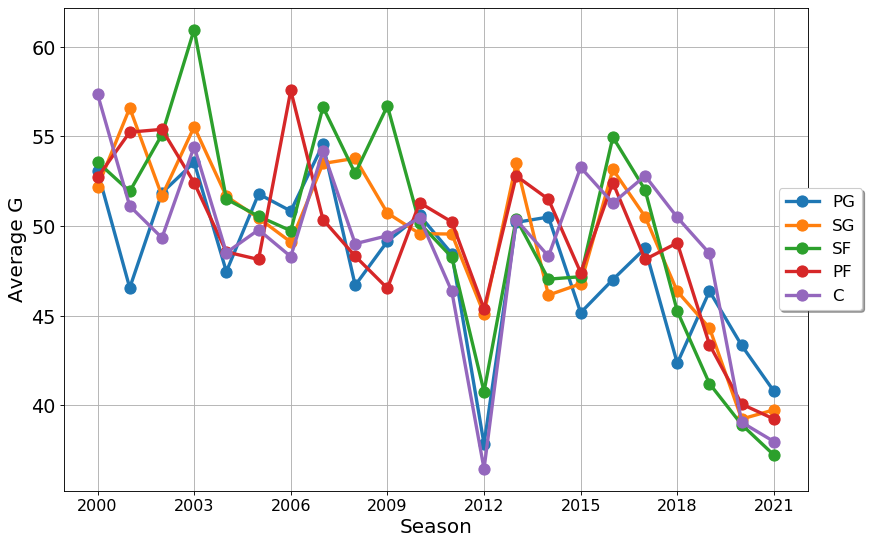

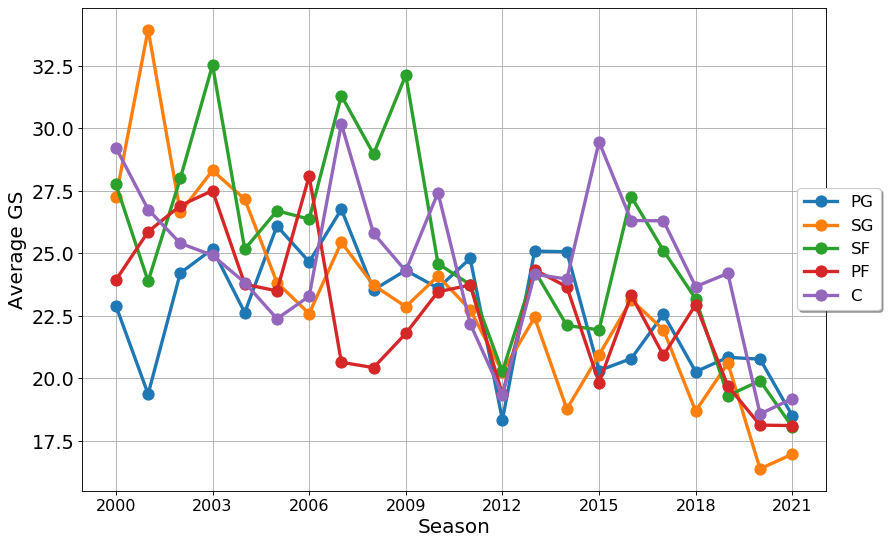

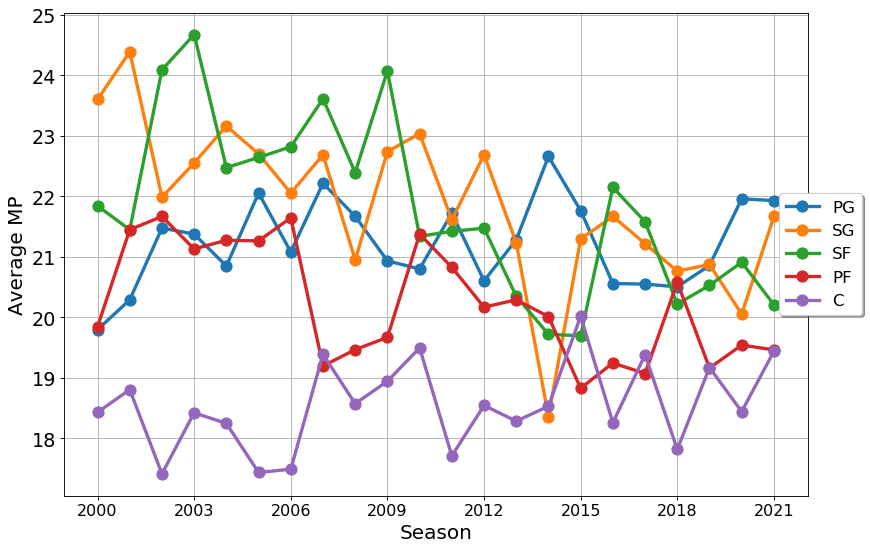

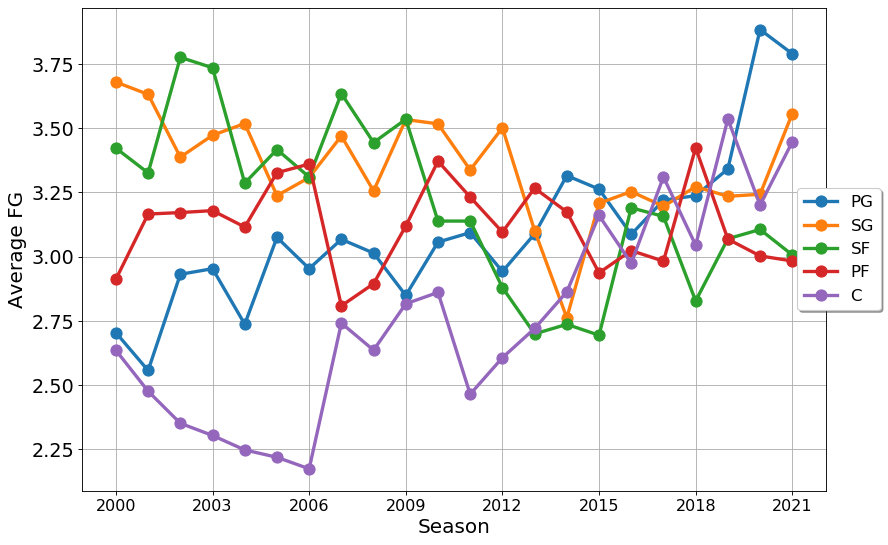

...

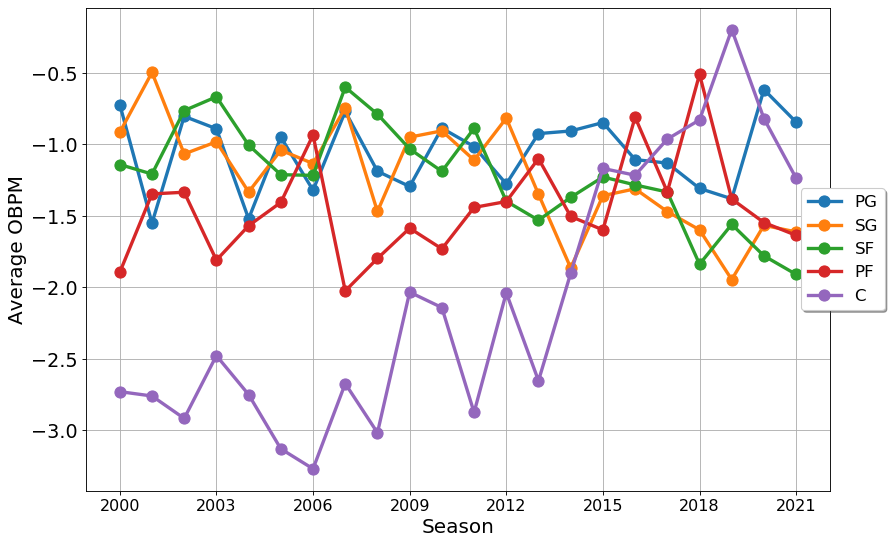

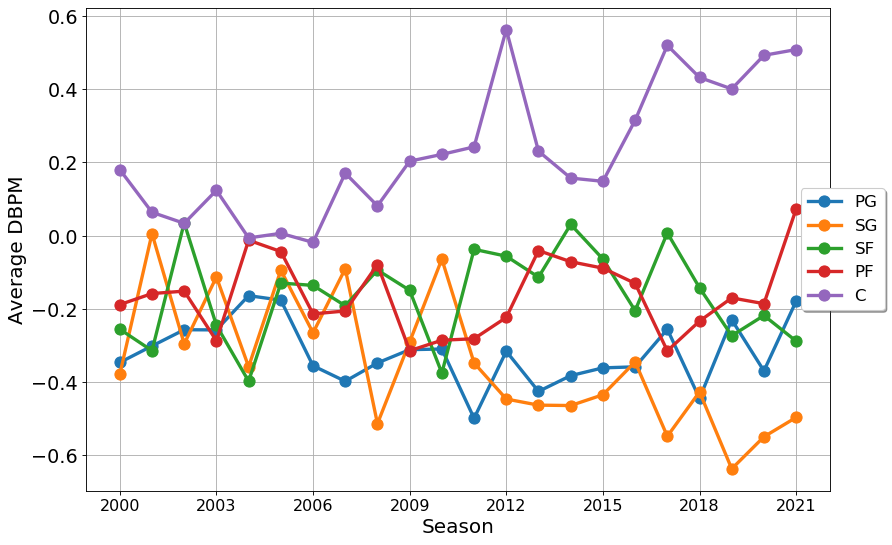

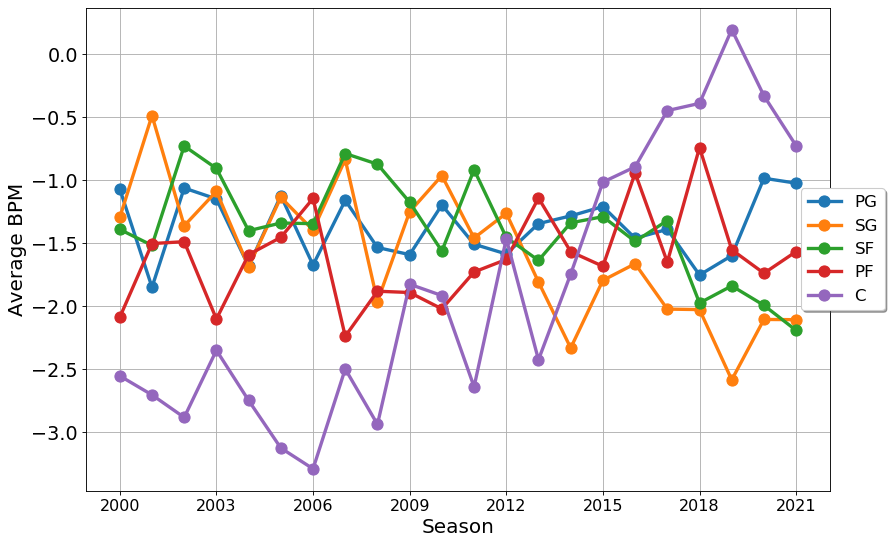

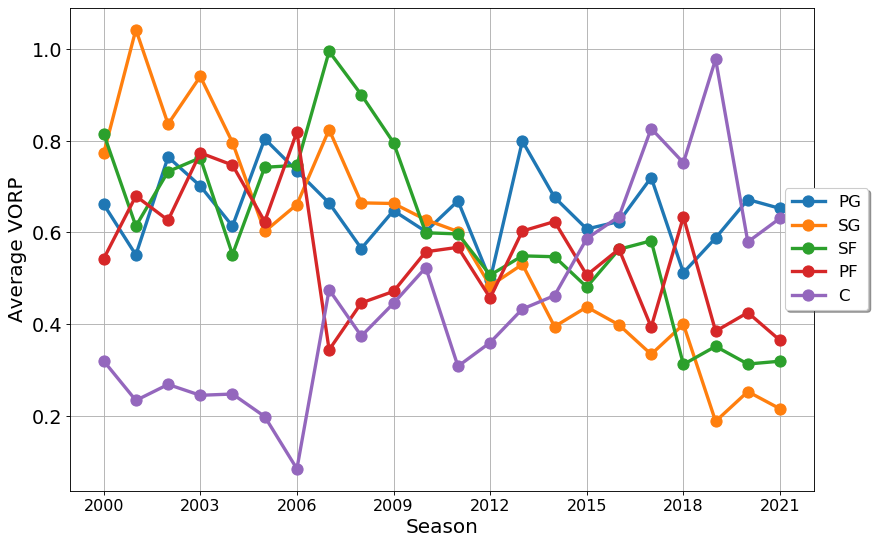

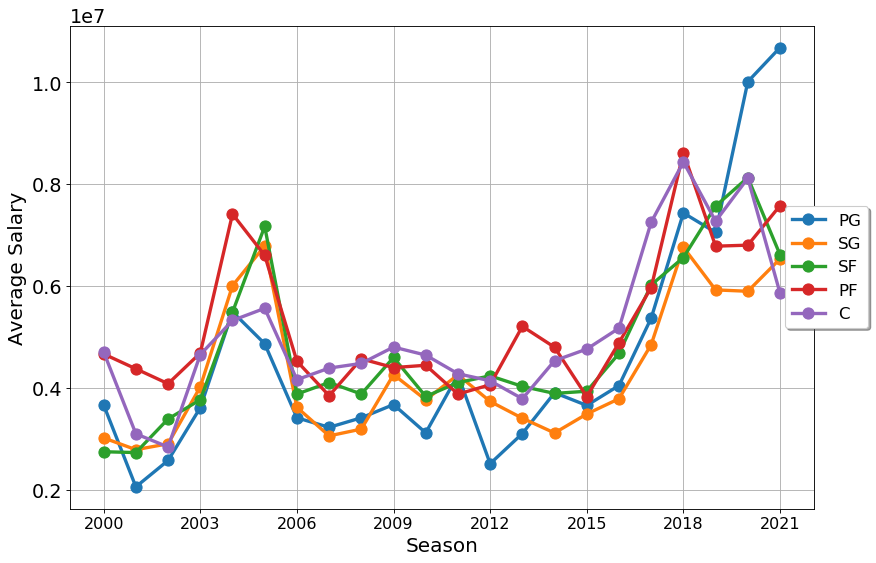

In [14]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_stat_by_position_each_season(stat, avg_by_pos)
    plot_position_graph(avg_by_pos_each_season, stat, "Average")

In [15]:
sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/StandardDeviationStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

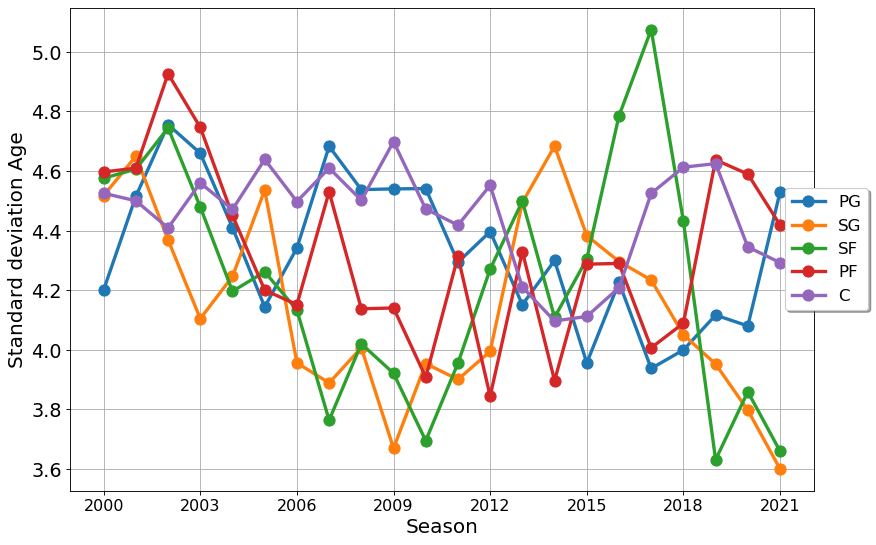

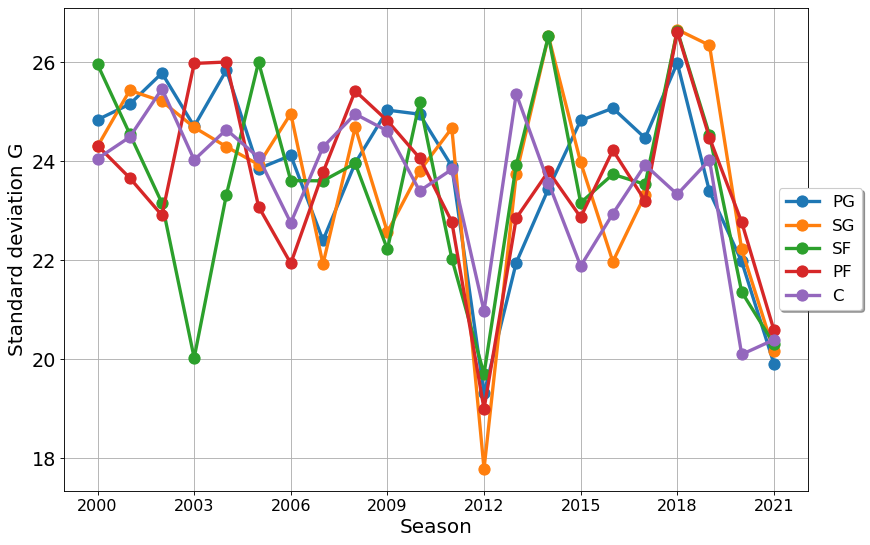

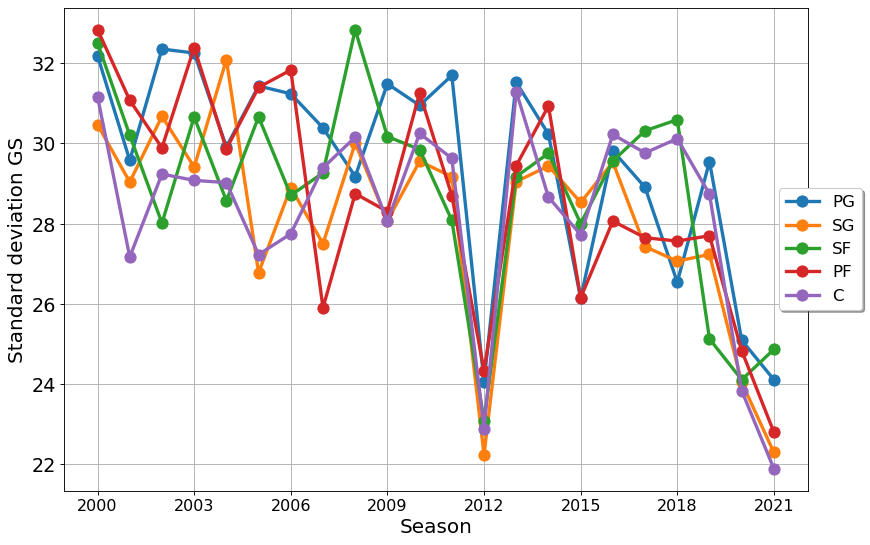

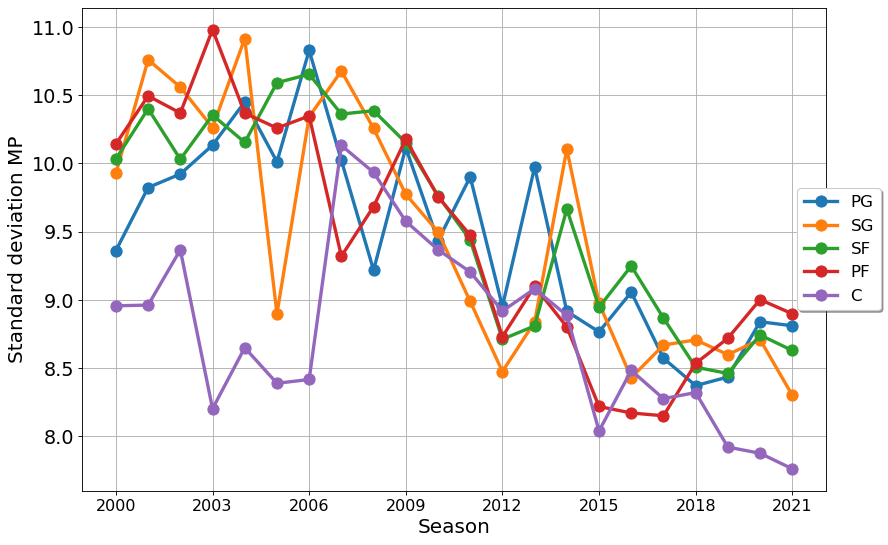

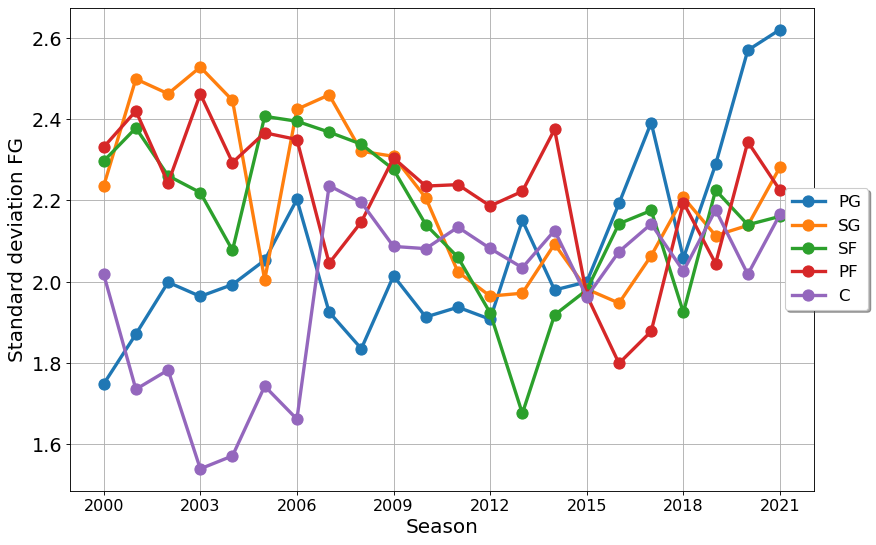

...

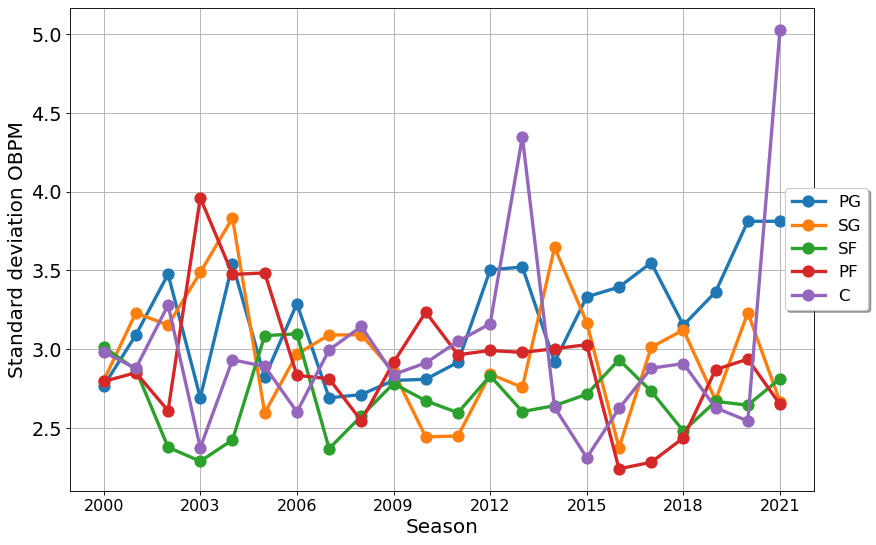

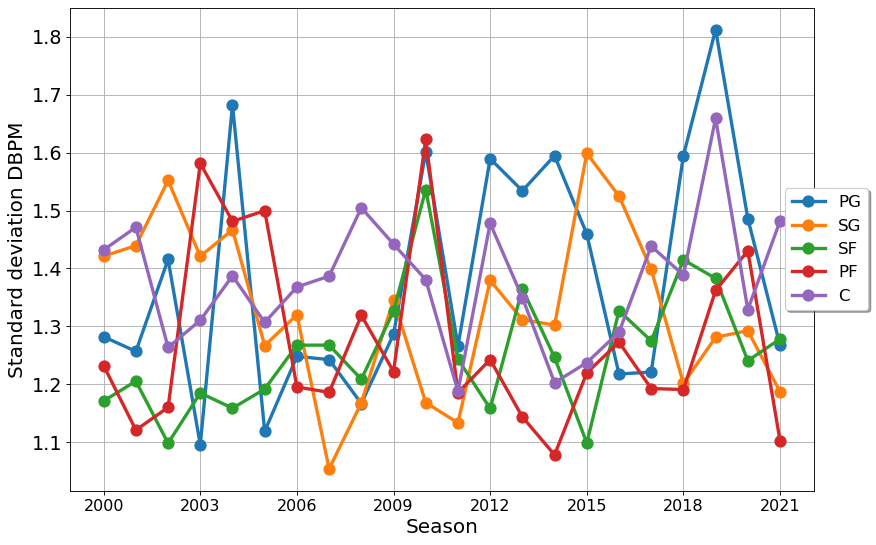

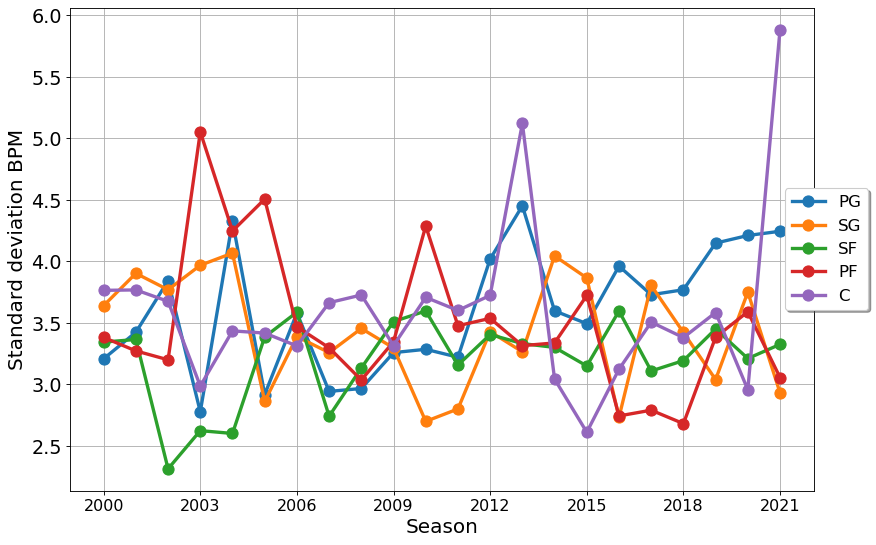

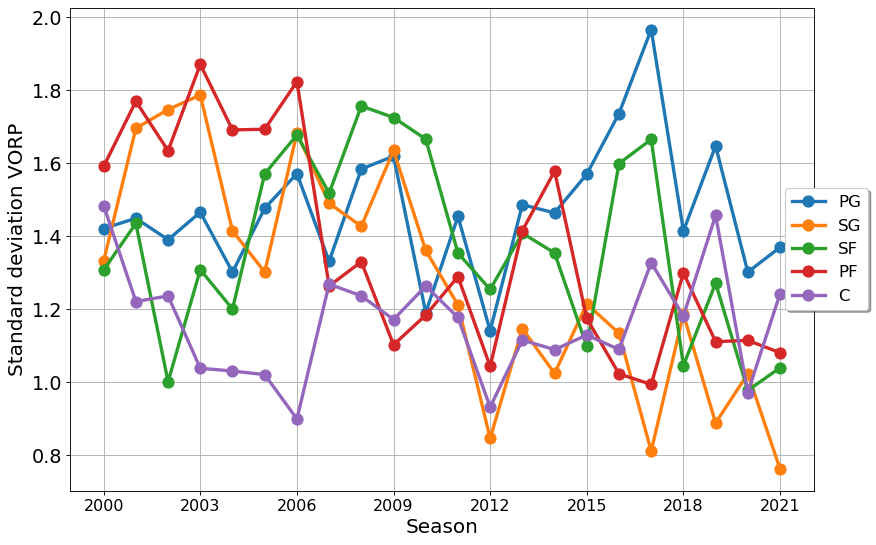

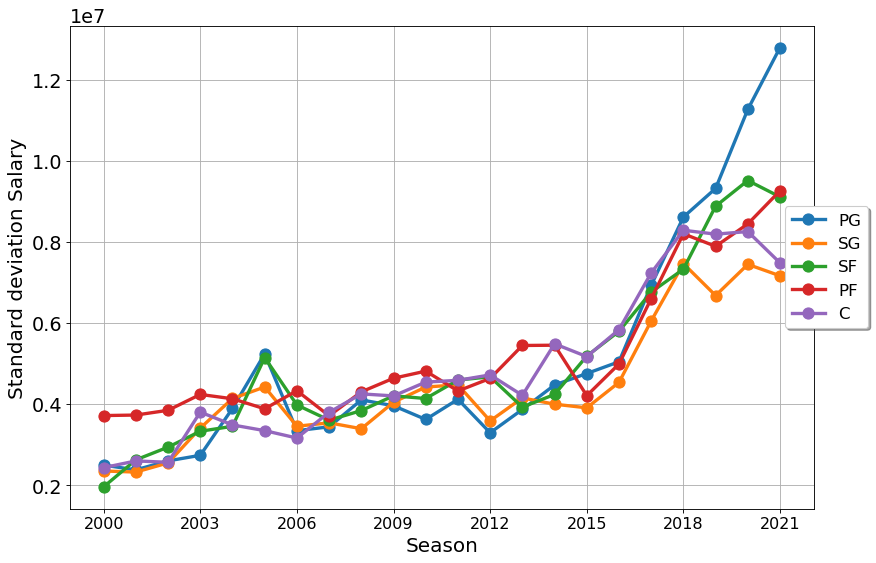

In [16]:
stats = sd_by_pos[0].columns
for stat in stats:
    sd_by_pos_each_season = get_stat_by_position_each_season(stat, sd_by_pos)
    plot_position_graph(sd_by_pos_each_season, stat, "Standard deviation")

In [17]:
median_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).median())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    median_by_pos.append(df)
#     df.to_csv("DataCollection/Positions/StandardDeviationStatsByPositon_{0}-{1}.csv".format(first_year, second_year))
    
    

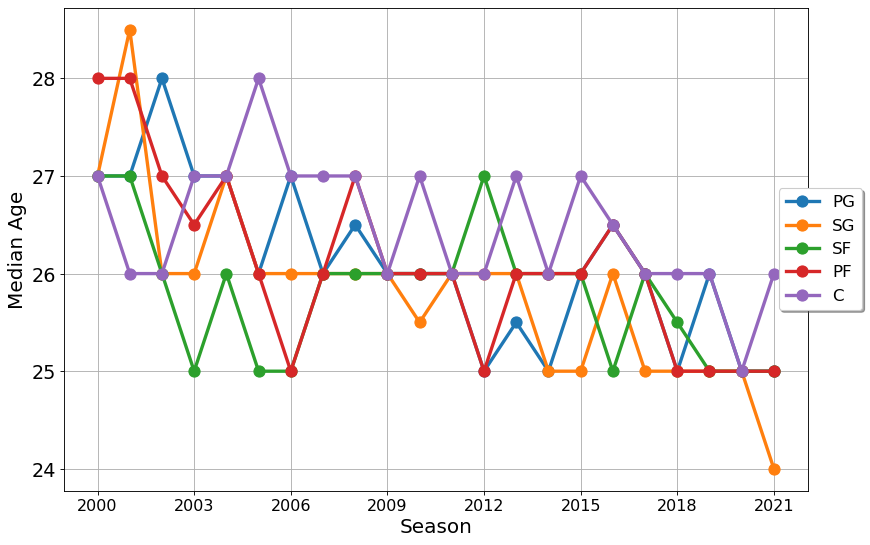

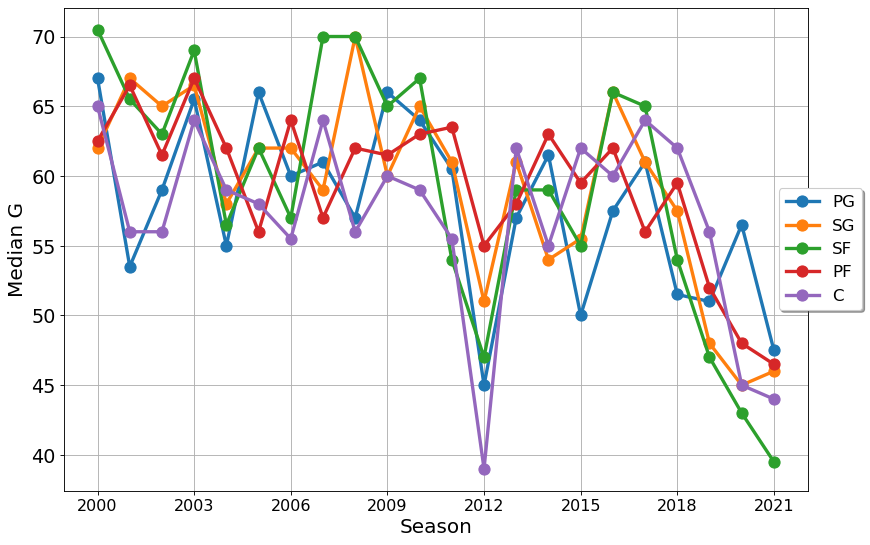

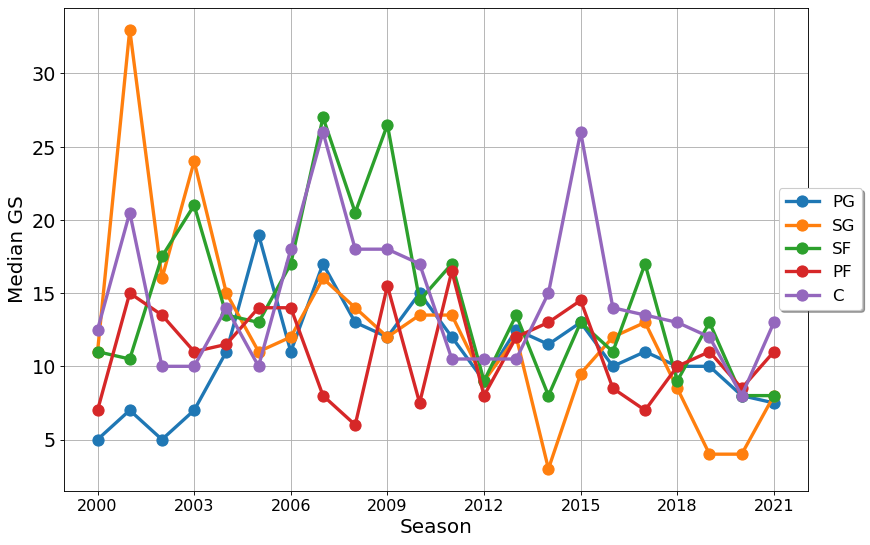

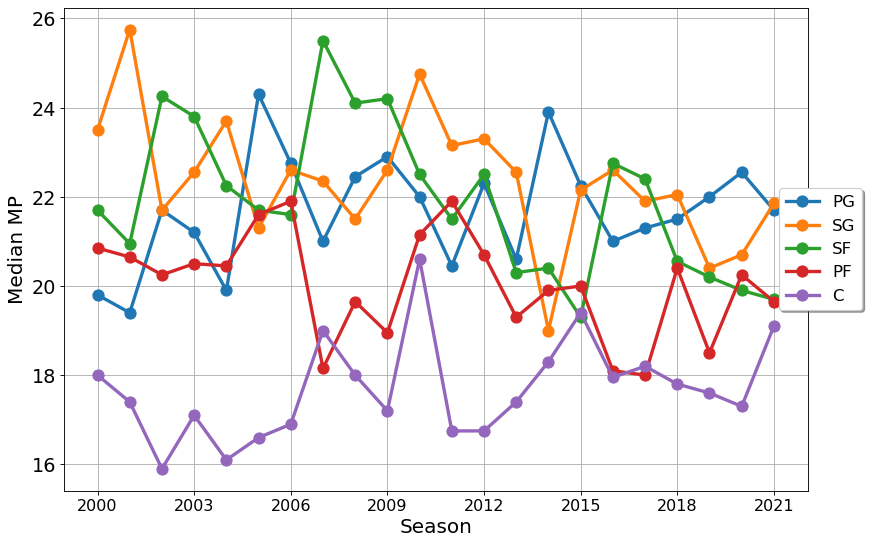

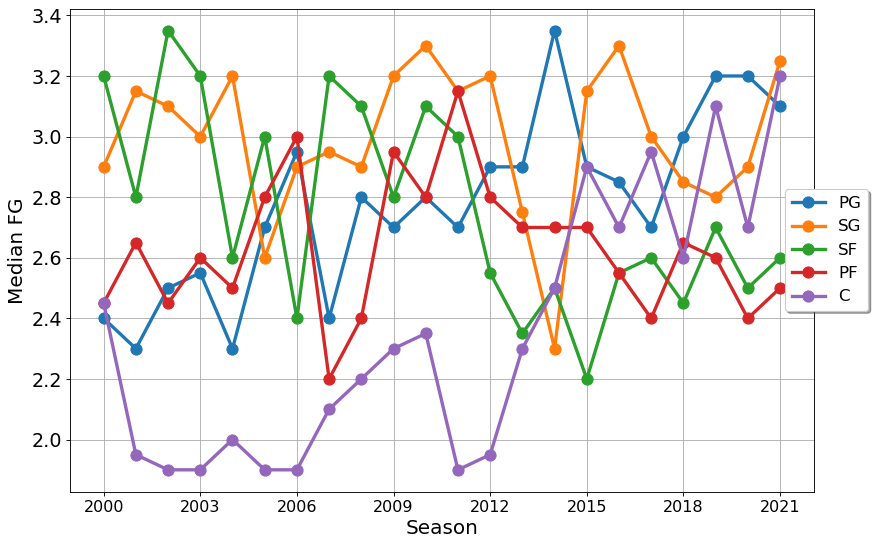

...

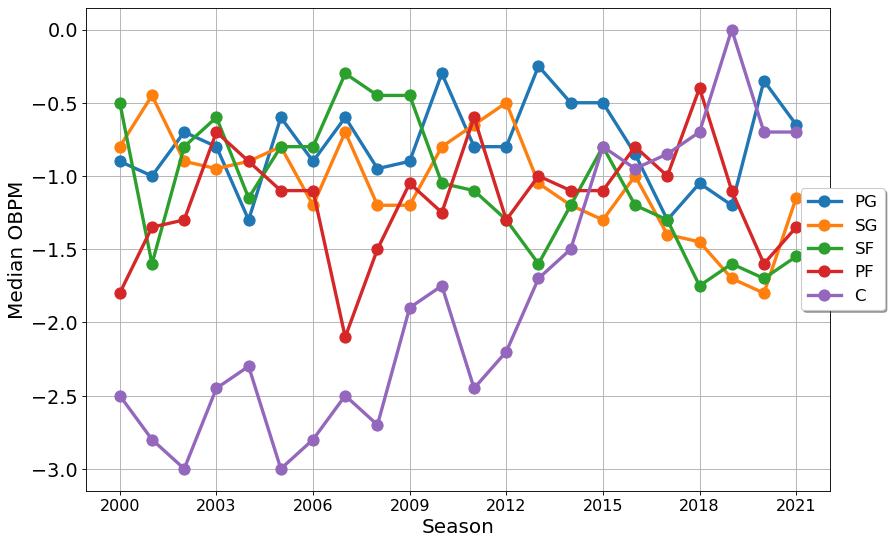

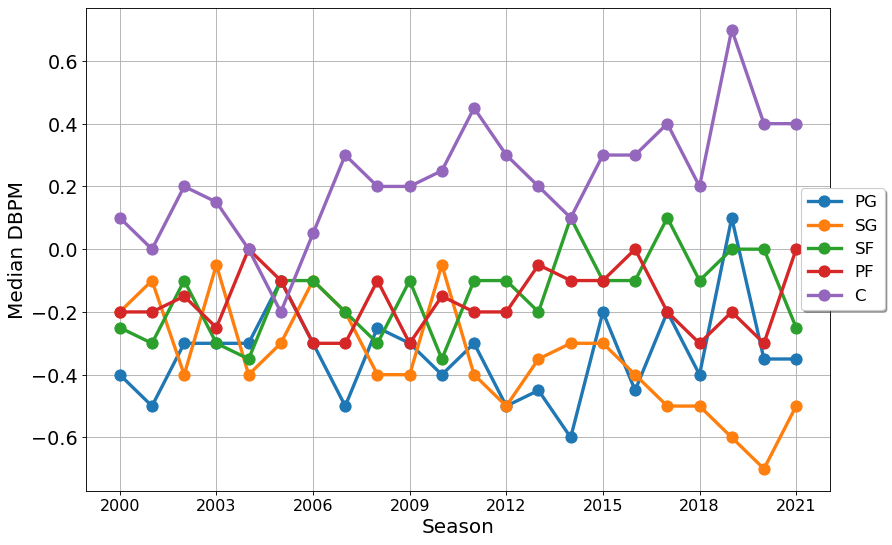

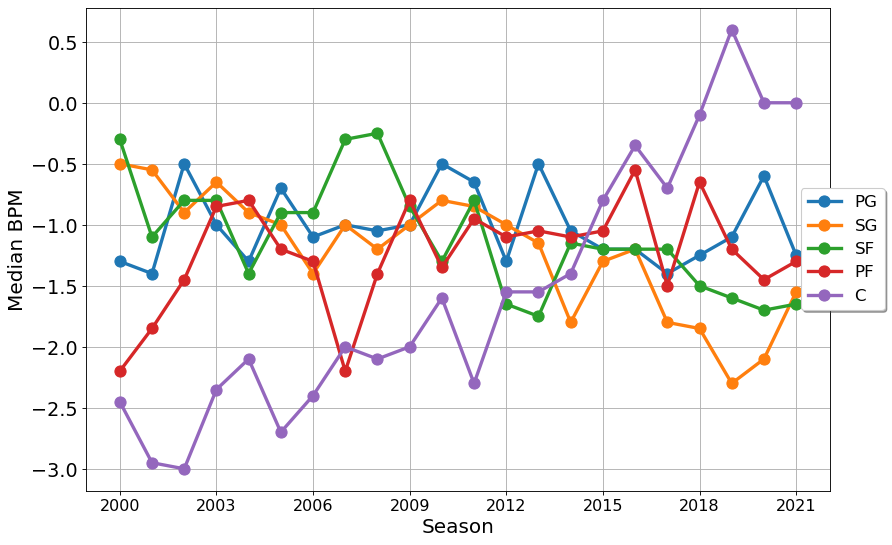

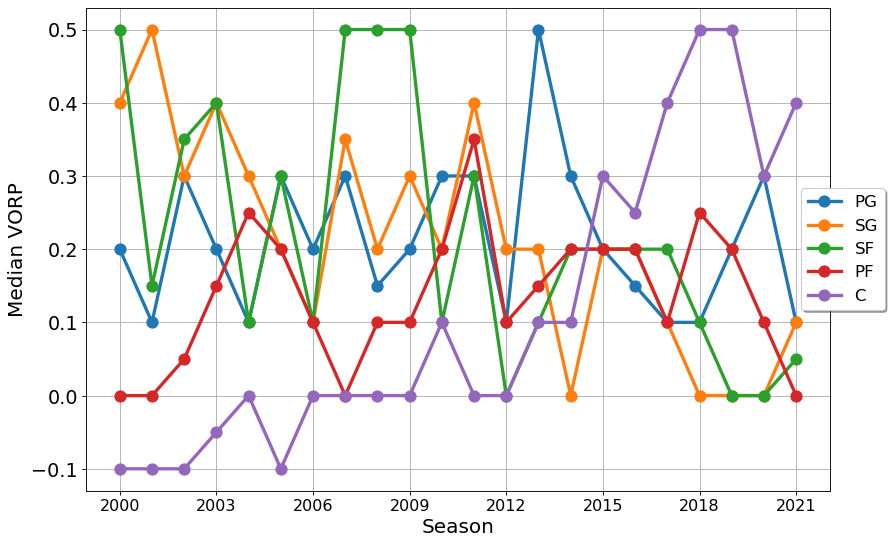

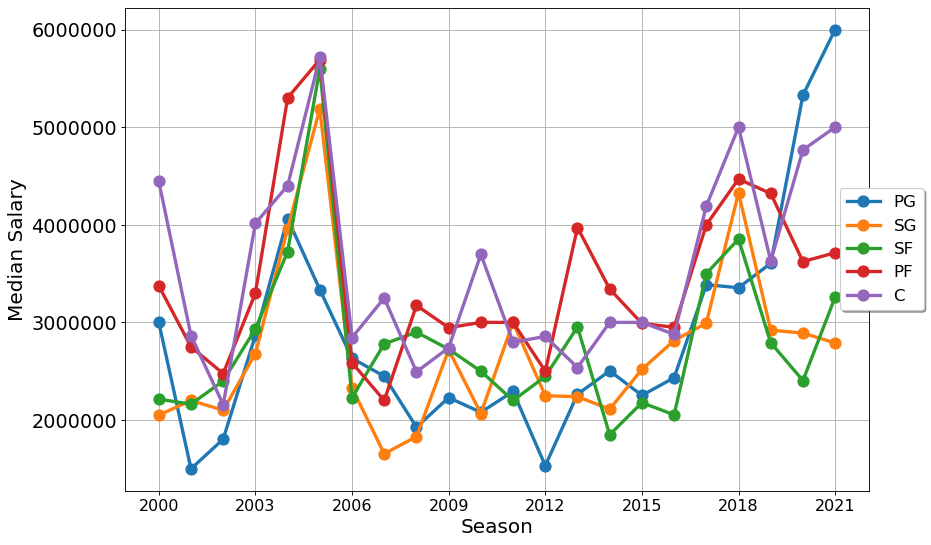

In [18]:
stats = median_by_pos[0].columns
for stat in stats:
    median_by_pos_each_season = get_stat_by_position_each_season(stat, median_by_pos)
    plot_position_graph(median_by_pos_each_season, stat, "Median")

# Analyzing highest scorers by position in the playoffs

In [19]:
#get average points for each position's leading scorer for every team
df = pd.DataFrame(playoff_player_dfs[18].groupby(by=['Tm','Pos'])['PTS'].max())
df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)

In [20]:
#Find the average points and the position of each team's leading scorer in each season

highest_scorer_by_pos_and_season = {}
for team in TEAMS:
    highest_scorer_by_pos_and_season[team] = {}
    
for i in range(len(SEASONS)):
    df = pd.DataFrame(playoff_player_dfs[i])
    df.sort_values(by=['Tm', 'PTS'], ascending=[True, False], inplace=True)
    for team in TEAMS:
        players_from_team = df[df['Tm'] == team]
        if not players_from_team.empty:
            highest_scorer_from_team = players_from_team.iloc[0][['Pos', 'PTS']]
            highest_scorer_by_pos_and_season[team][SEASONS[i]] = list(highest_scorer_from_team)

In [21]:
#Find how many teams had a leading scorer of each position each season

position_with_more_scoring = {}

for position in POSITIONS:
    position_with_more_scoring[position] = np.zeros(len(SEASONS), dtype=int)
    
for i in range(len(SEASONS)):
    season = SEASONS[i]
    for team in TEAMS:
        if season in highest_scorer_by_pos_and_season[team]:
            position = highest_scorer_by_pos_and_season[team][season][0]
            if position in POSITIONS:        
                position_with_more_scoring[position][i] += 1

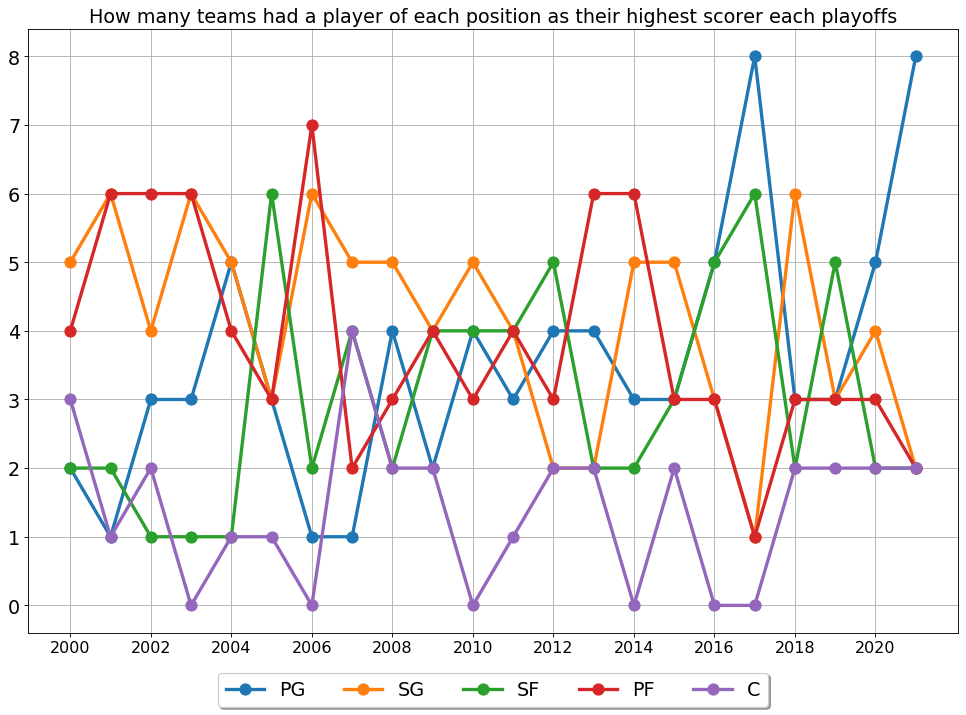

In [22]:
plt.figure(figsize=(15, 10), dpi=80)
plt.grid()
for position in POSITIONS:
    plt.plot(SEASONS, position_with_more_scoring[position], label=position, lw=3, marker='o', ms=10)
    
    
plt.title("How many teams had a player of each position as their highest scorer each playoffs")
plt.xticks(SEASONS[::2])
plt.legend(loc='upper center', bbox_to_anchor=(0.5, -0.05),
          fancybox=True, shadow=True, ncol=5)
plt.savefig("Results/PositionsEvolution_Playoffs/Positions_with_most_scoring_in_the_playoffs.png")
plt.show()

# Analyzing the impact of positions by average stats

In [23]:
#Get average stats for each position in every season
avg_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).mean())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    avg_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/AverageStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

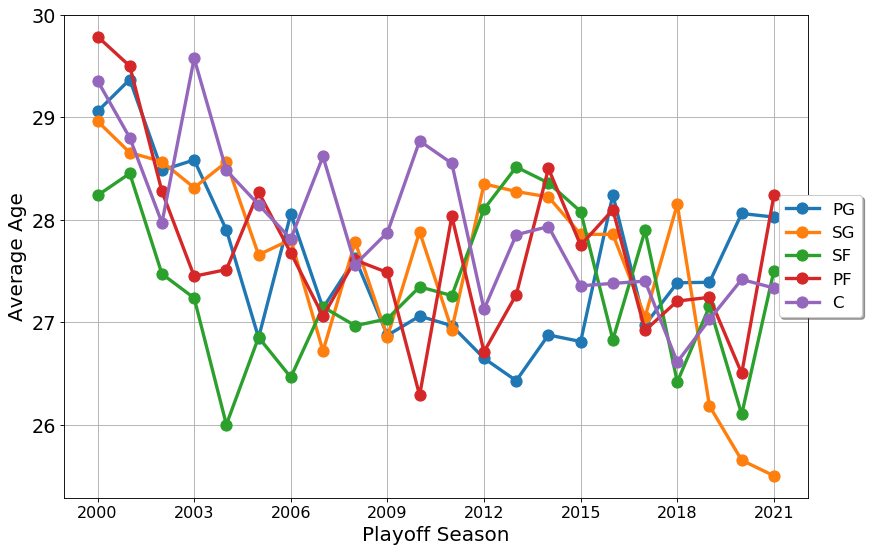

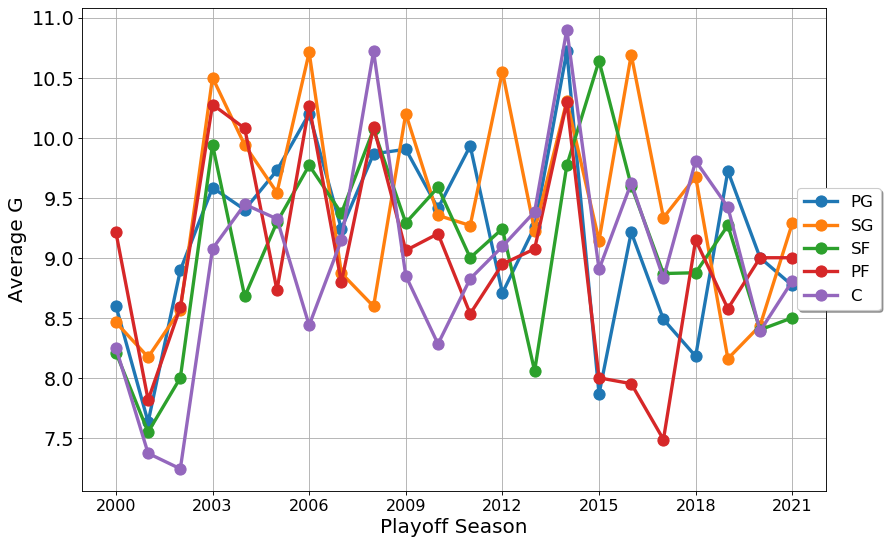

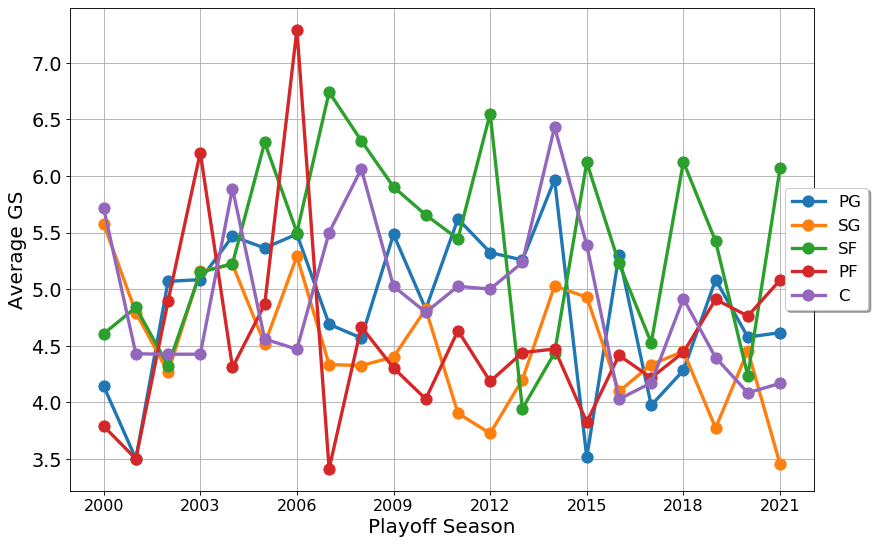

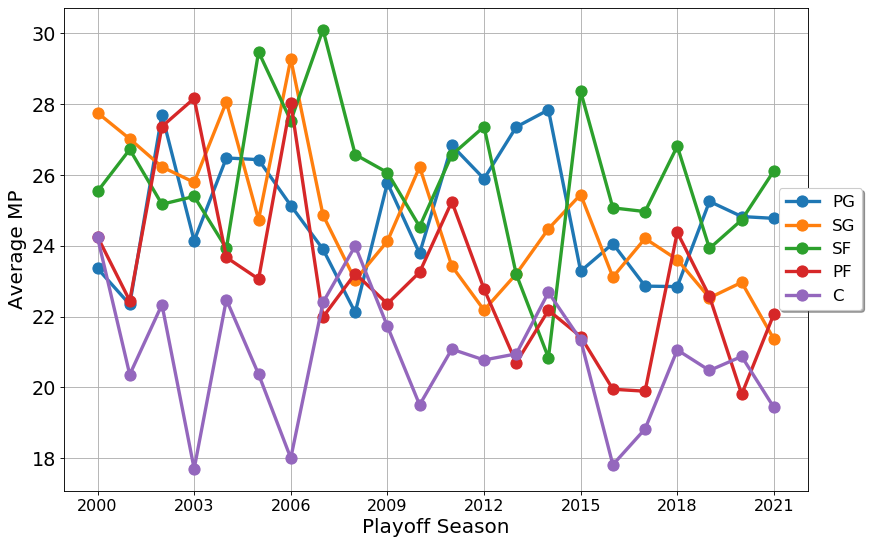

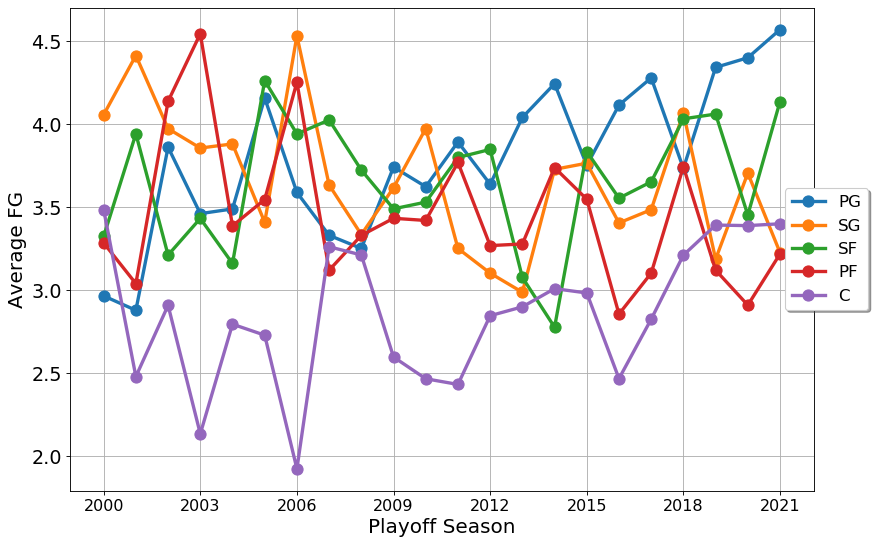

...

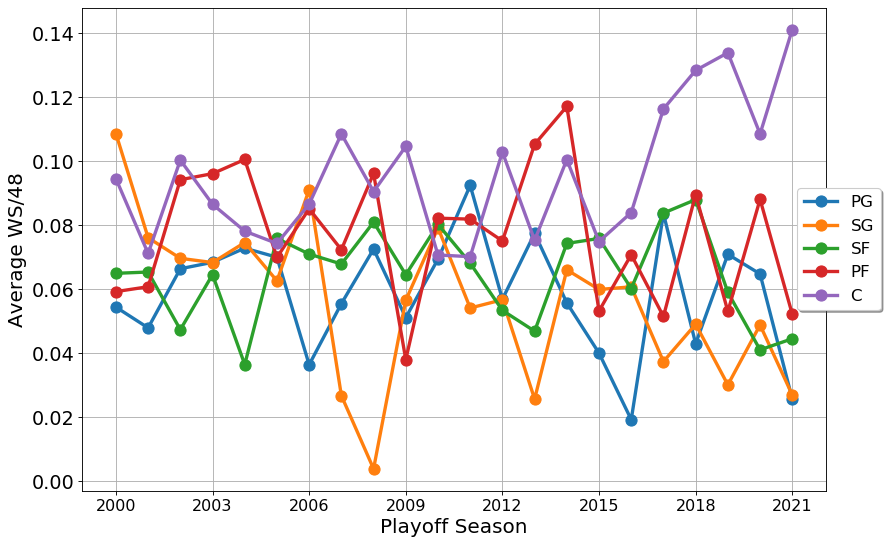

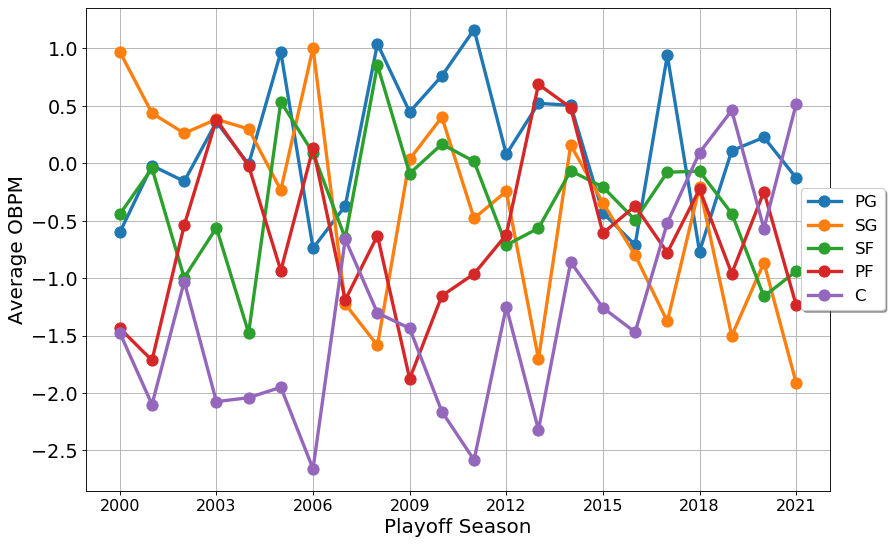

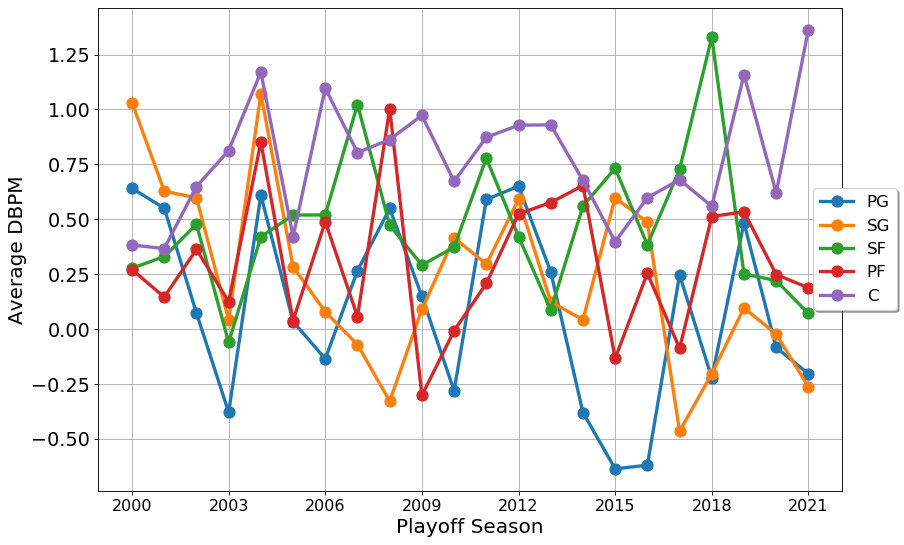

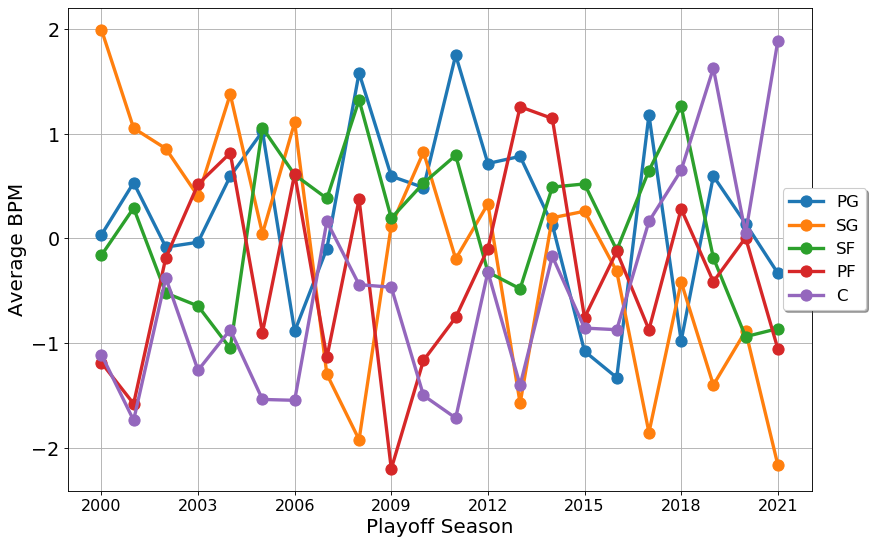

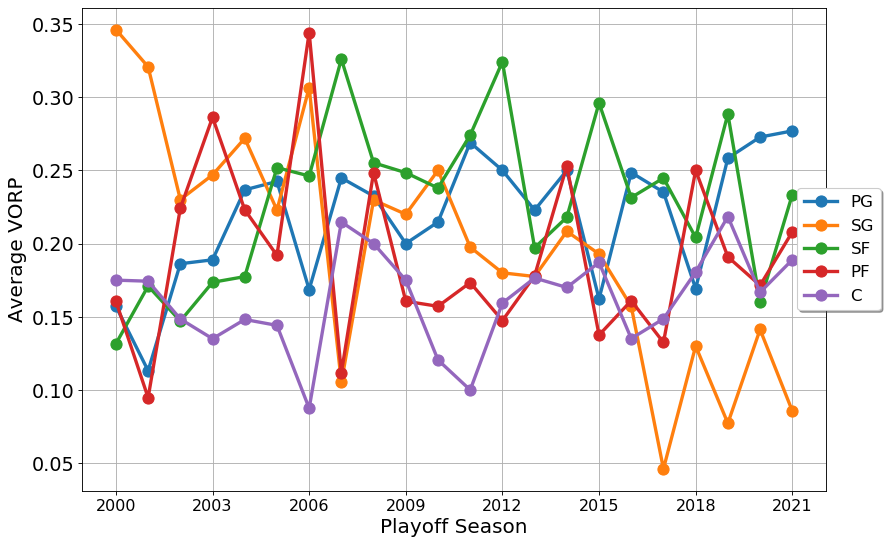

In [24]:
stats = avg_by_pos[0].columns
for stat in stats:
    avg_by_pos_each_season = get_stat_by_position_each_season(stat, avg_by_pos)
    plot_position_graph(avg_by_pos_each_season, stat, "Average", True)

In [25]:
#Get standard deviation of stats for each position in every season

sd_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).std())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    sd_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/StandardDeviationStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

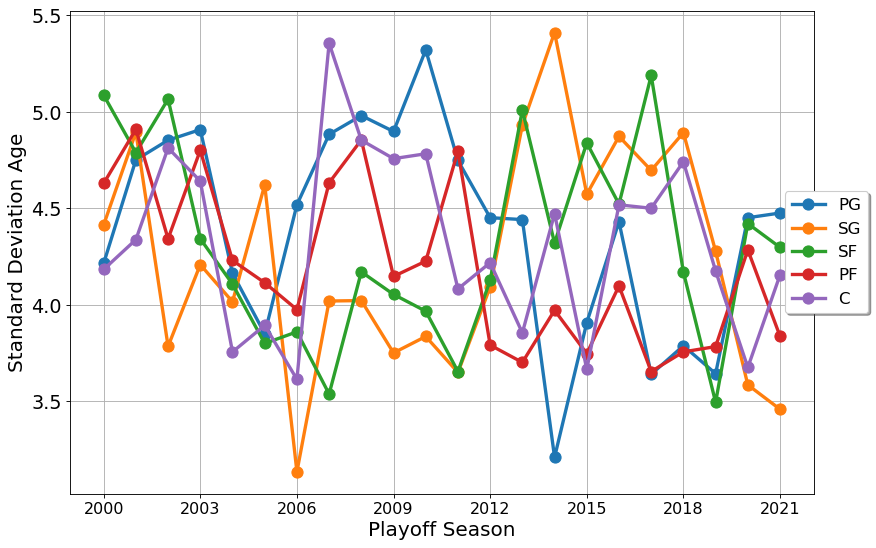

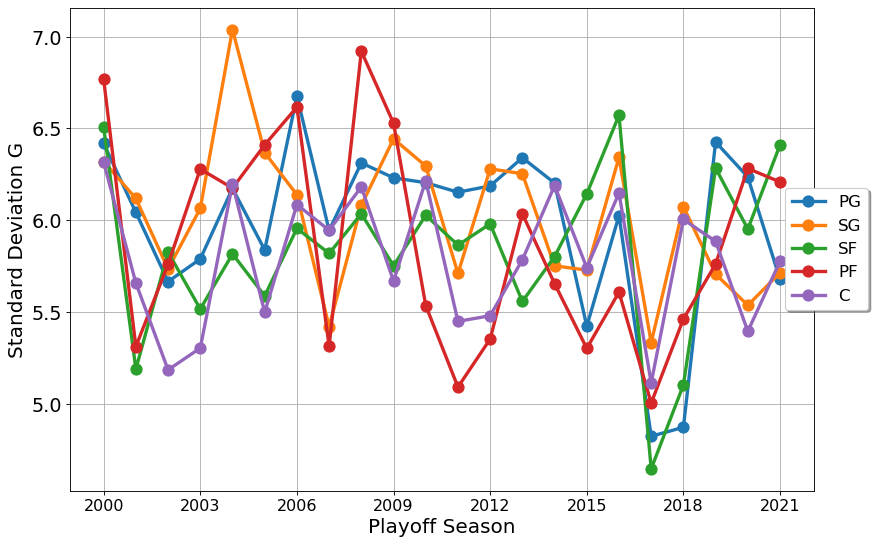

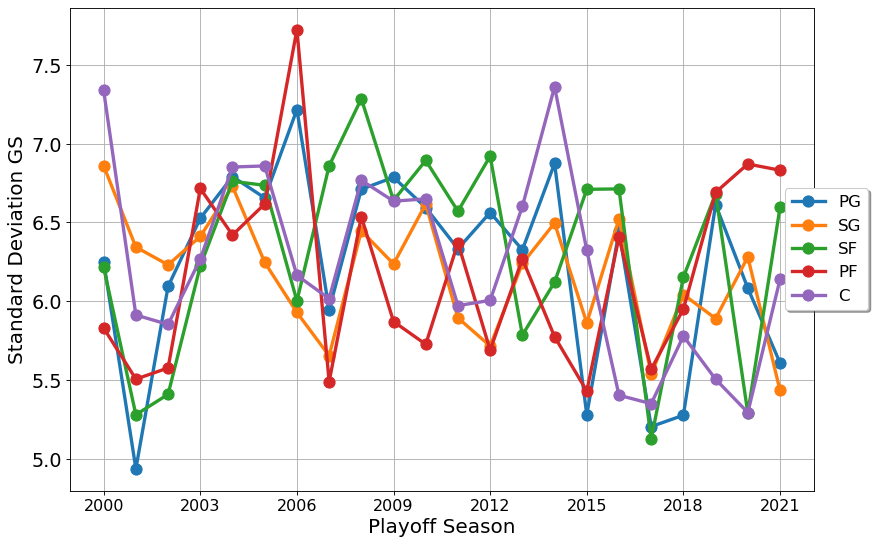

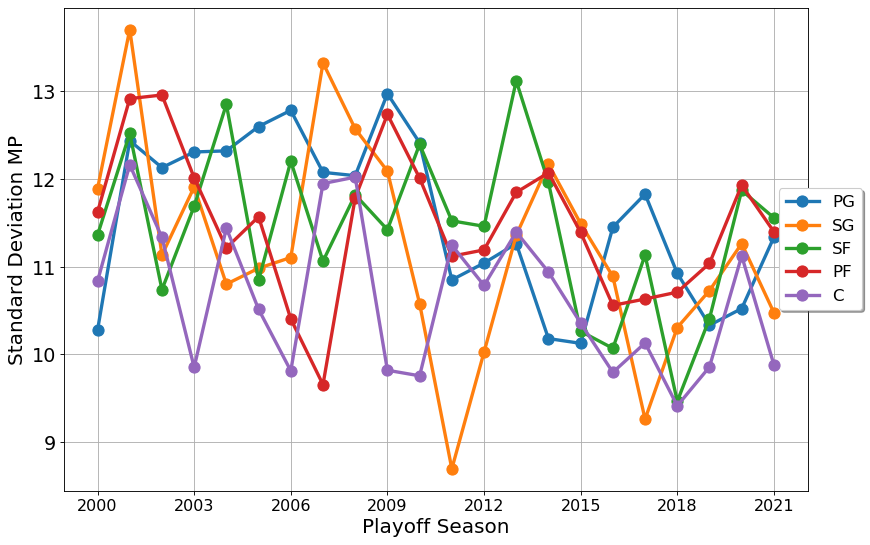

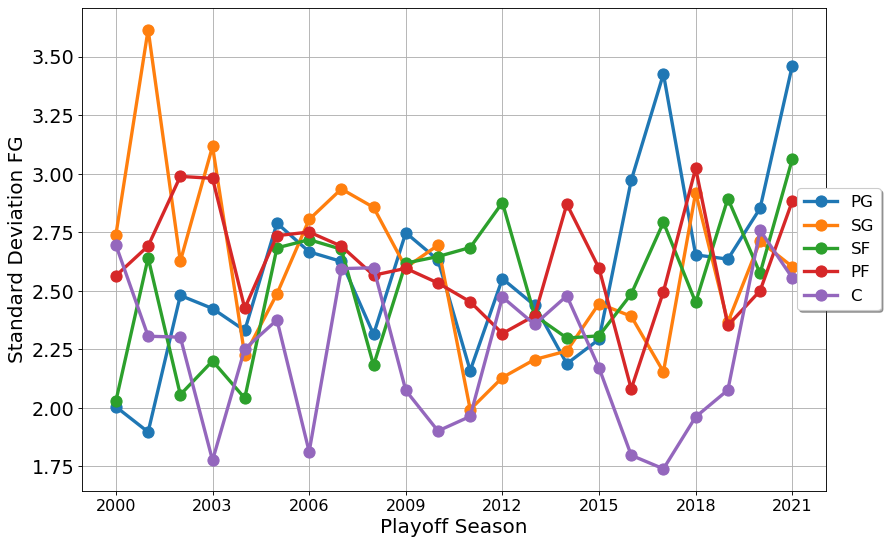

...

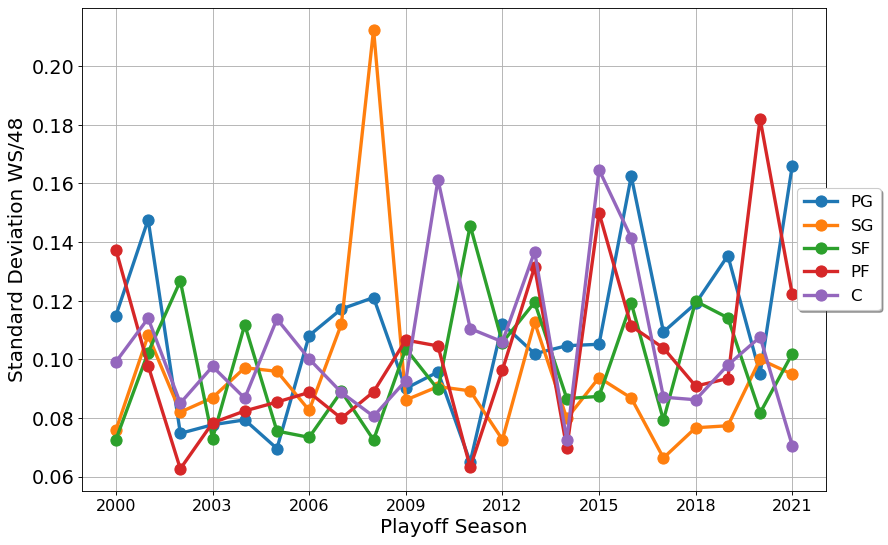

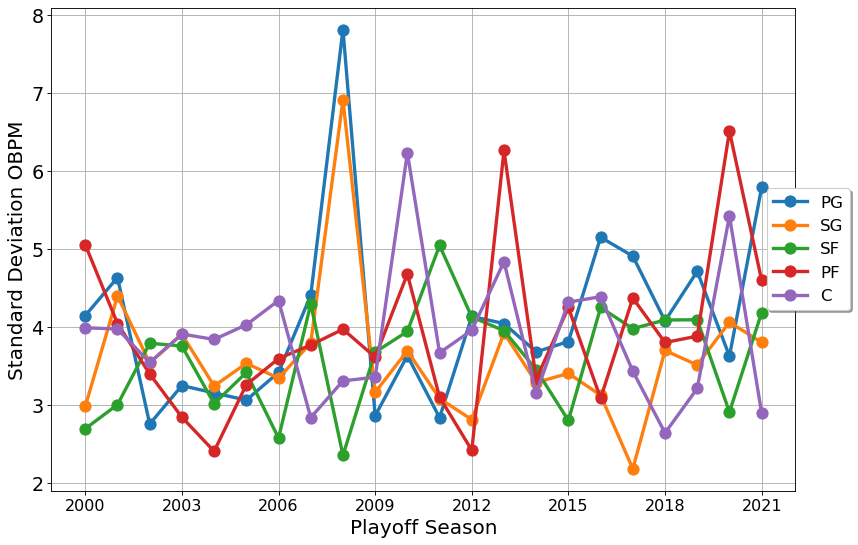

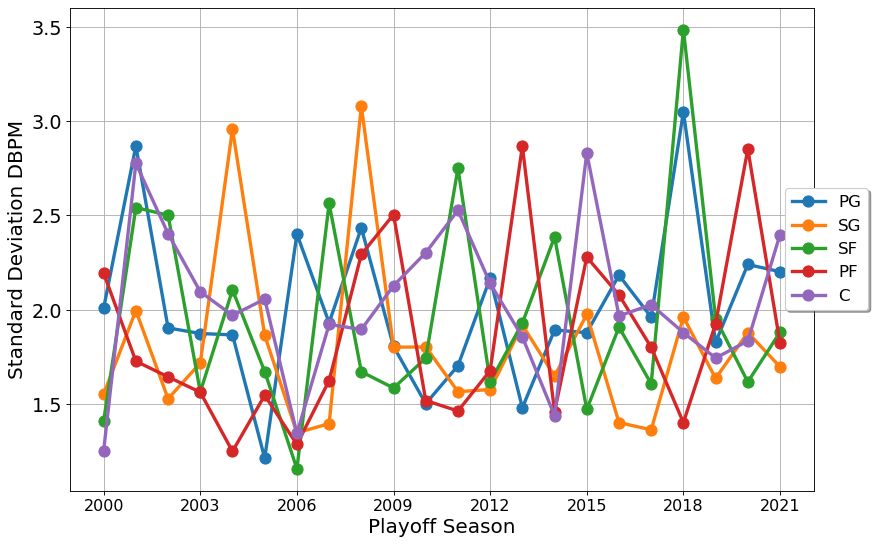

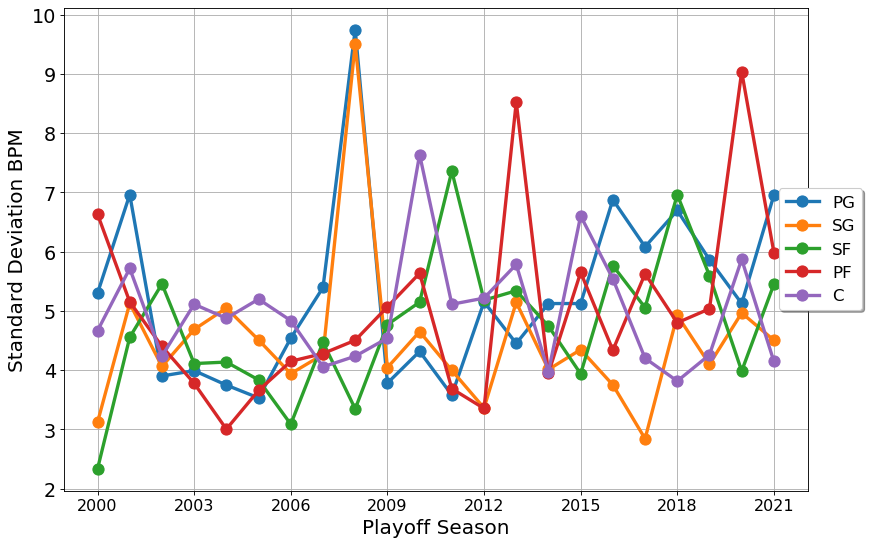

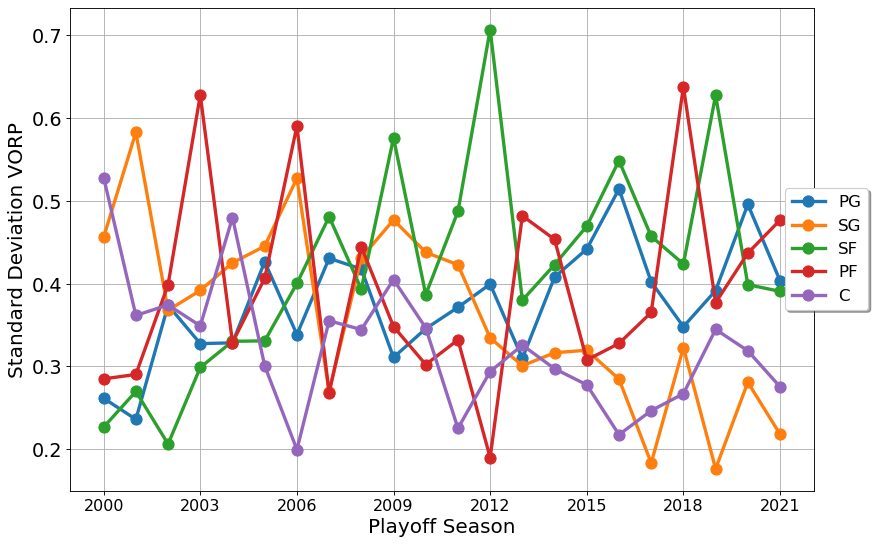

In [26]:
stats = avg_by_pos[0].columns
for stat in stats:
    sd_by_pos_each_season = get_stat_by_position_each_season(stat, sd_by_pos)
    plot_position_graph(sd_by_pos_each_season, stat, "Standard Deviation", True)

In [27]:
#Get standard deviation of stats for each position in every season

median_by_pos = []

for i in range(len(SEASONS[:])):
    first_year, second_year = format_season(SEASONS[i])
    df = playoff_player_dfs[i].sort_values(by=['G'], ascending=False)
    df = df[df["Tm"] != "TOT"]
    df = df[df["MP"] >= 5]
    df = df.drop_duplicates(subset ="Player",keep = "first")
    df = pd.DataFrame(df.groupby(by=['Pos']).median())
    df.sort_values(by='PTS', ascending=False, inplace=True)
    median_by_pos.append(df)
    #df.to_csv("DataCollection/Positions_Playoffs/MedianStatsByPositon_Playoffs_{0}-{1}.csv".format(first_year, second_year))
    
    

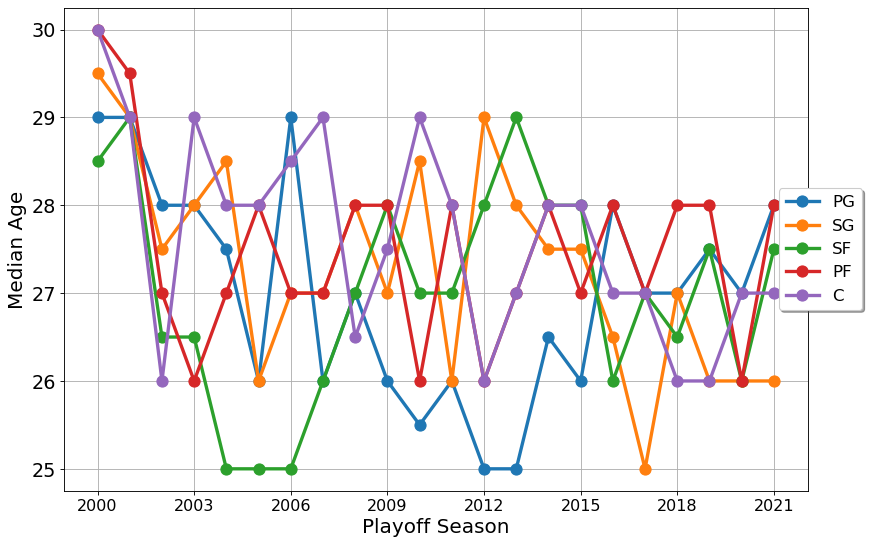

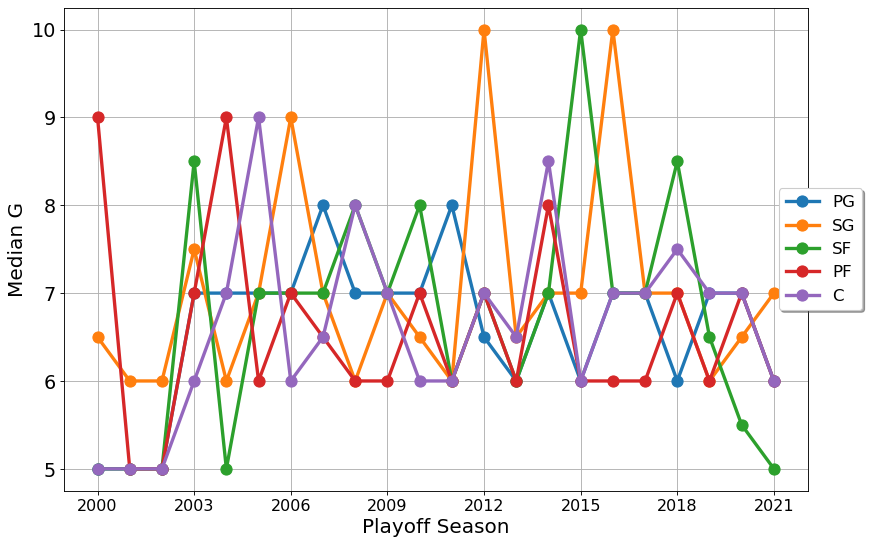

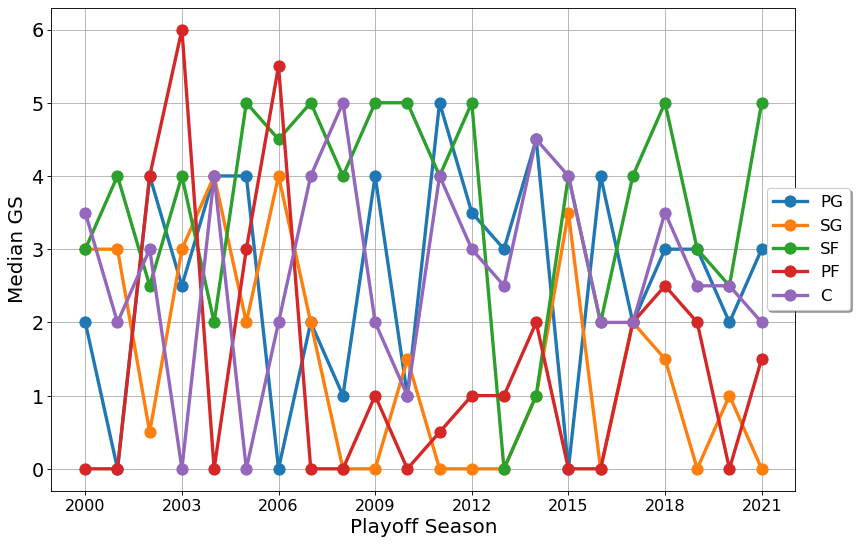

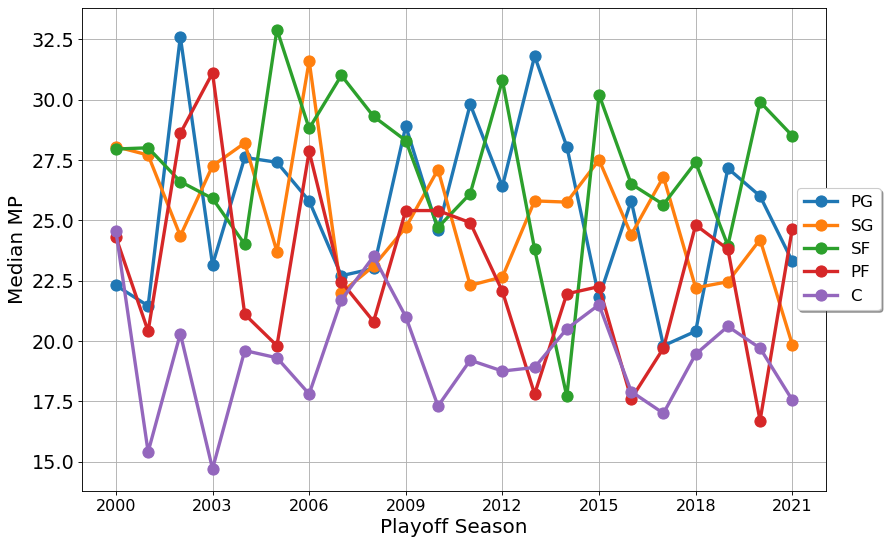

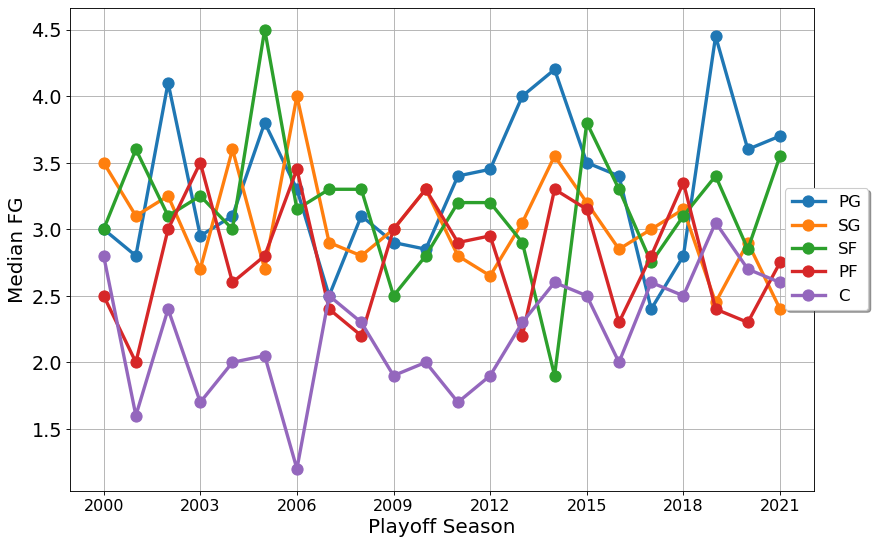

...

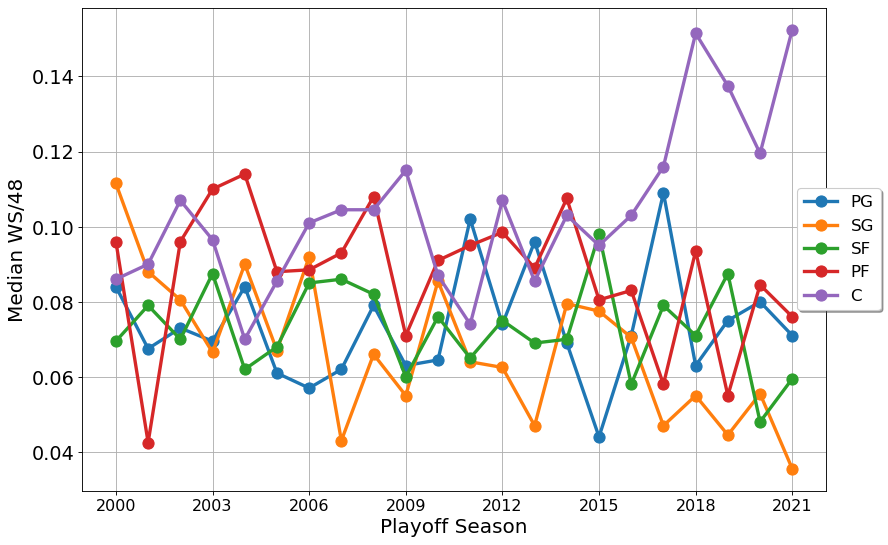

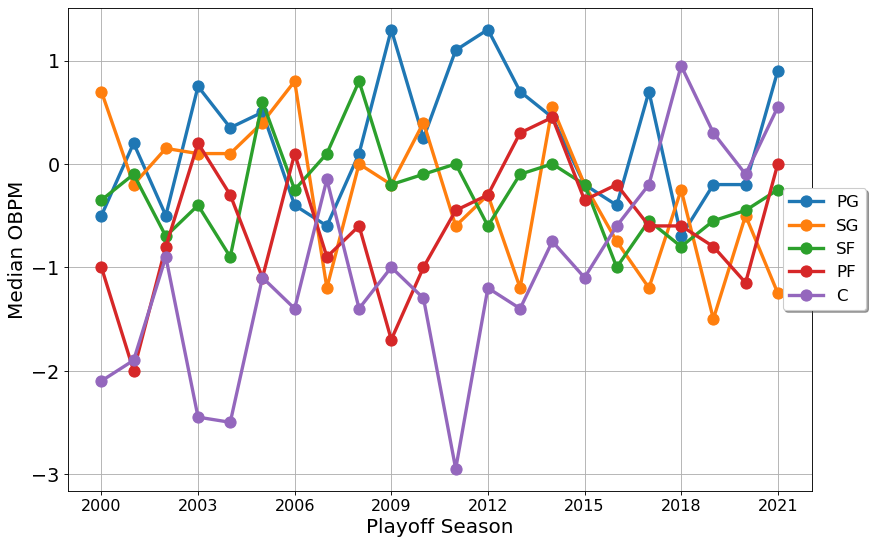

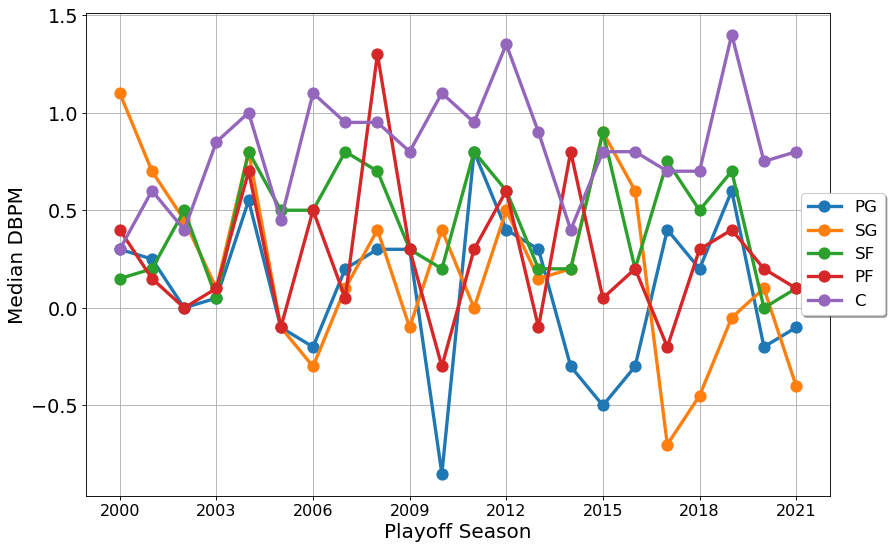

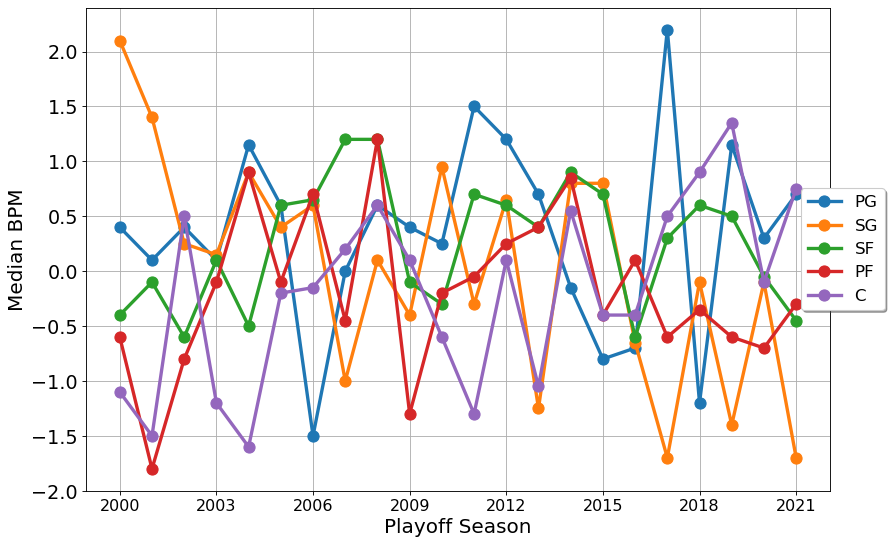

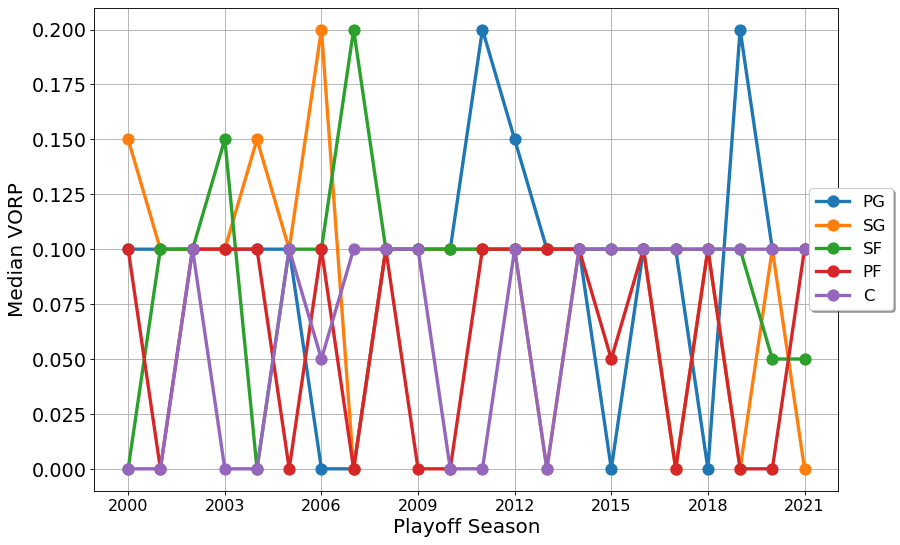

In [28]:
stats = median_by_pos[0].columns
for stat in stats:
    median_by_pos_each_season = get_stat_by_position_each_season(stat, median_by_pos)
    plot_position_graph(median_by_pos_each_season, stat, "Median", True)